In [1]:
import os
import datetime
import requests
import PIL
from PIL import Image

from IPython.display import display

## Download the image

In [2]:
def get_file(path: str, save_file_name=None):
  if path.startswith("http"):
    try:
      headers = {
              "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) \
              AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36"
          }
      res = requests.get(path, headers=headers)
      res.raise_for_status()  # Raise an error for bad responses (e.g., 404)
      content = res.content
      save_file_name = save_file_name or datetime.datetime.now().strftime("%d%m%y_%H%M%S%f") + "." + path.split(".")[-1]
      with open(save_file_name, "wb") as fp:
        fp.write(content)
      return save_file_name
    except requests.exceptions.HTTPError as http_err:
        raise Exception(f"HTTP error occurred: {http_err}")
    except Exception as err:
        raise Exception(f"Error occurred: {err}")
  else:
    print("URL invalid. Only the HTTP protocol is allowed.")
    raise Exception("Getting error with path: Please use `wget url` in bash to download file ")


In [3]:
IMAGE_URL = "https://images.all-free-download.com/images/graphicwebp/beautiful_natural_scenery_553758.webp"
image_path1 = get_file(IMAGE_URL)

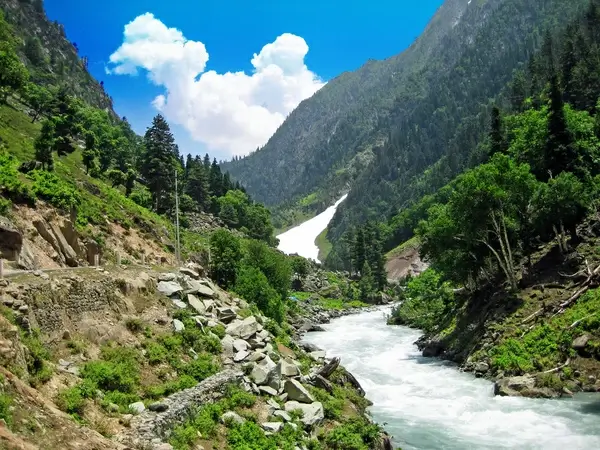

In [4]:
original_image = PIL.Image.open(image_path1)
# show actual image
# original_image.show()
original_image

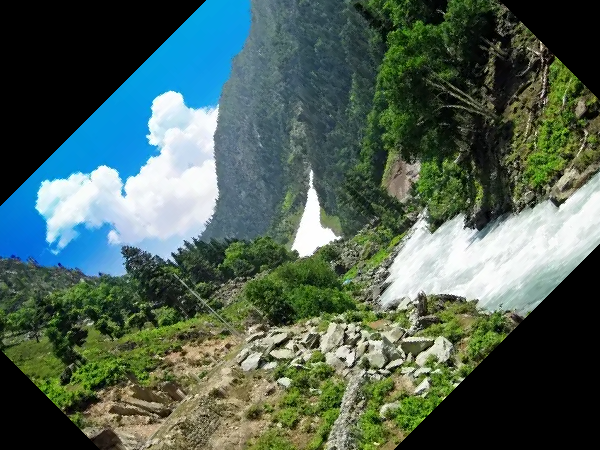

In [5]:
# rotate image
rotate_image = original_image.rotate(45)
rotate_image

### Display image Metadata

In [6]:
def display_image_info(image):
    """
    Display information about a given image.

    Args:
        image (Pillow Image): The image whose information is to be displayed.

    Prints:
        Filename of the image.
        Format of the image.
        Format description of the image.
        File pointer of the image.
        Mode of the image.
        Size of the image.
        Additional information about the image.
    """
    print("Filename of image: ", image.filename)
    print("Format of image: ", image.format)
    print("Format description of image: ", image.format_description)
    print("Image filepointer: ", image.fp)
    print("Image Mode: ", image.mode)
    print("Image size: ", image.size)
    print("Info about image: ", image.info)

display_image_info(original_image)

Filename of image:  /workspaces/Machine-learning-Project/PILLOW IMAGE PROCESSING/010624_125525082368.webp
Format of image:  WEBP
Format description of image:  WebP image
Image filepointer:  None
Image Mode:  RGB
Image size:  (600, 450)
Info about image:  {'loop': 1, 'background': (255, 255, 255, 255), 'timestamp': 0, 'duration': 0}


### **Splitting image**
Modes: [modes and bands docs](https://pillow.readthedocs.io/en/stable/handbook/concepts.html)

In [7]:
def concatenated_image(image1, image2, image3):
    """
    Concatenates three images of the same dimensions side by side.

    Args:
        image1 (PIL.Image.Image): The first image to be concatenated.
        image2 (PIL.Image.Image): The second image to be concatenated.
        image3 (PIL.Image.Image): The third image to be concatenated.

    Returns:
        PIL.Image.Image: A new image that is the result of concatenating the three input images horizontally.

    Raises:
        AssertionError: If the dimensions of the three images are not the same.

    Example:
        >>> from PIL import Image
        >>> image1 = Image.open('path_to_image1.jpg')
        >>> image2 = Image.open('path_to_image2.jpg')
        >>> image3 = Image.open('path_to_image3.jpg')
        >>> combined_image = concatenated_image(image1, image2, image3)
        >>> combined_image.show()

    Notes:
        - Ensure that all three images have the same dimensions before calling this function.
        - The returned image will have a width that is triple the width of the individual images and the same height.
    """
    assert image1.size == image2.size == image3.size, "Make sure the dimensions of all three images are the same"
    
    # Get the dimensions of the images
    width, height = image1.size

    # Create a new image with triple the width for horizontal concatenation
    combined_image = Image.new('RGB', (width * 3, height))

    # Paste the images side by side
    combined_image.paste(image1, (0, 0))
    combined_image.paste(image2, (width, 0))
    combined_image.paste(image3, (2 * width, 0))

    return combined_image

[INFO]: Image order is Split of RGB band of image
[info]: Combined image of split band rrr, bbb and ggg of RGB image


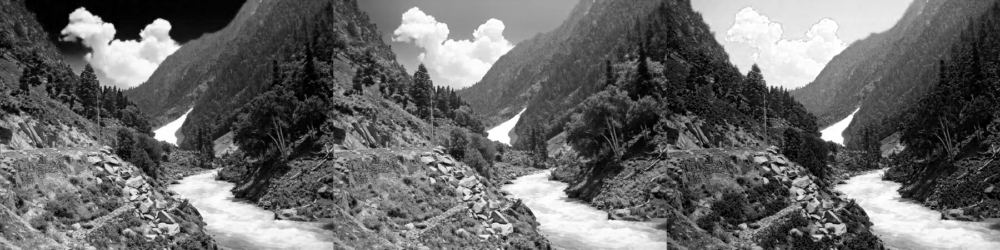

In [8]:
# Split the image into its red, green, and blue bands
# see image mode to see unpacking image
r, g, b = original_image.split()

# Convert single band images to RGB before pasting
r_rgb = Image.merge('RGB', (r, r, r))
g_rgb = Image.merge('RGB', (g, g, g))
b_rgb = Image.merge('RGB', (b, b, b))

print("[INFO]: Image order is Split of RGB band of image")
print("[info]: Combined image of split band rrr, bbb and ggg of RGB image")
combined_image = concatenated_image(r_rgb, g_rgb, b_rgb)

# Display the combined image
display(combined_image)

### **Merging image**

[INFO]: Concatenated image of exchanging the order of coloring
[info]: Order of concatenation bgr, gbr and rgb


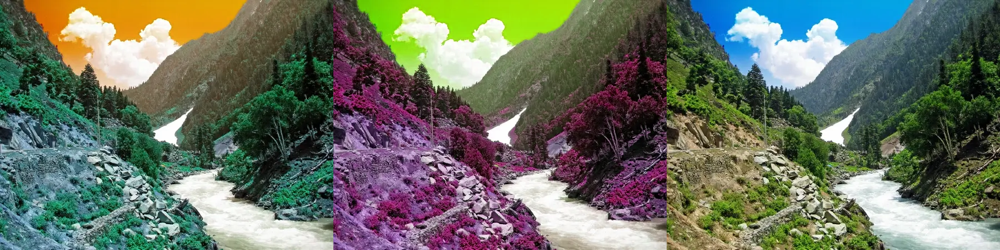

In [9]:
r, g, b = original_image.split()
# merge in different order 
merged_image_bgr = PIL.Image.merge("RGB", (b, g, r))
merged_image_gbr = PIL.Image.merge("RGB", (g, b, r))
merged_image_rgb = PIL.Image.merge("RGB", (r, g, b))

print("[INFO]: Concatenated image of exchanging the order of coloring")
print("[info]: Order of concatenation bgr, gbr and rgb")
combined_image_permute_rgb1 = concatenated_image(merged_image_bgr, merged_image_gbr, merged_image_rgb)
combined_image_permute_rgb1

[INFO]: Concatenated image of exchanging the order of coloring
[info]: Order of concatenation brg, grb and rbg


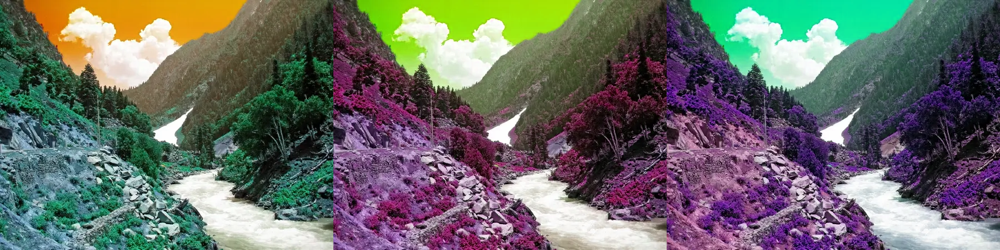

In [10]:
# merge in different order 
merged_image_brg = PIL.Image.merge("RGB", (b, r, g))
merged_image_grb = PIL.Image.merge("RGB", (g, r, b))
merged_image_rbg = PIL.Image.merge("RGB", (r, b, g))

print("[INFO]: Concatenated image of exchanging the order of coloring")
print("[info]: Order of concatenation brg, grb and rbg")
combined_image_permute_rgb2 = concatenated_image(merged_image_bgr, merged_image_gbr, merged_image_rbg)
combined_image_permute_rgb2

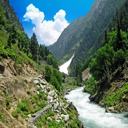

In [11]:
# resized image
resized_image = original_image.resize((128, 128))
resized_image

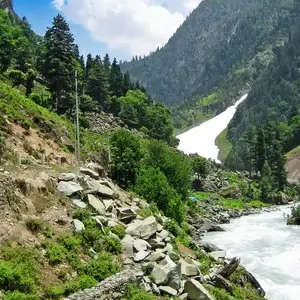

In [12]:
# 4-tuple, where coordinates are (left, upper, right, lower)
box = (100, 100, 400, 400)
region = original_image.crop(box=box)
region

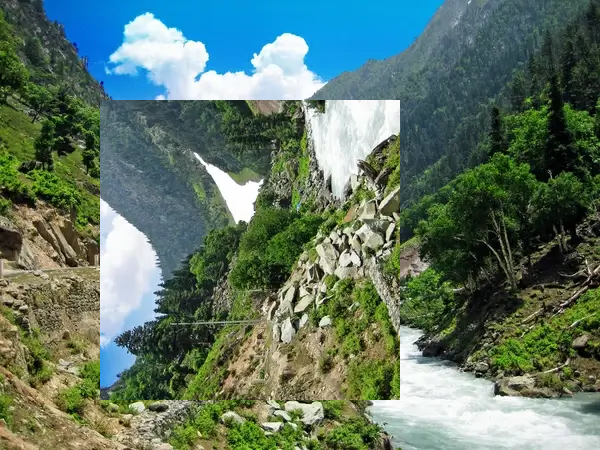

In [13]:
region = region.transpose(PIL.Image.Transpose.ROTATE_90)
# Processing a subrectangle, and pasting it back
original_image.paste(region, box)
original_image

Mode:  L


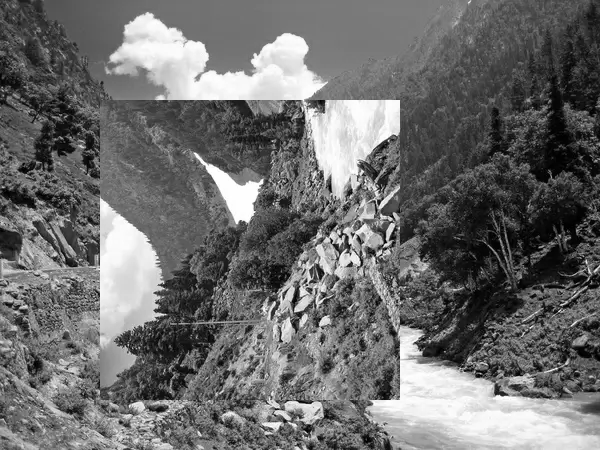

In [14]:
# convert image to grayscale
converted_image = original_image.convert(mode="L")
print("Mode: ", converted_image.mode)
converted_image

Mode:  CMYK


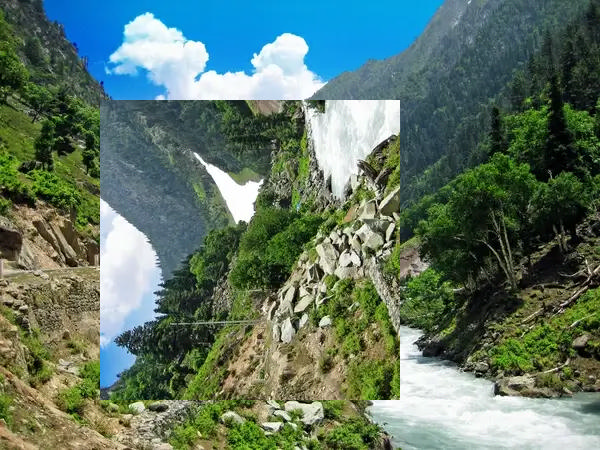

In [15]:
converted_image_cmyk = original_image.convert(mode="CMYK")
print("Mode: ", converted_image_cmyk.mode)
converted_image_cmyk

### Save image

In [16]:
converted_image_cmyk.save("converted_image.jpg", "JPEG")

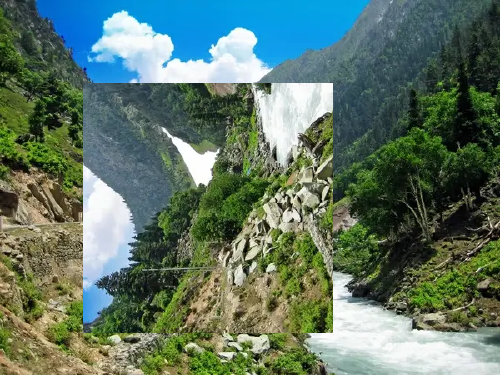

In [17]:
original_image.thumbnail((500, 500), resample=4)
original_image

### **Filter**

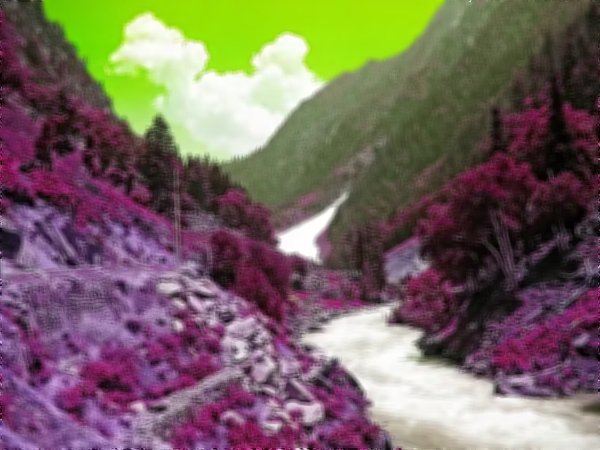

In [18]:
from PIL import ImageFilter
blur_image = merged_image_gbr.filter(ImageFilter.BLUR)
blur_image

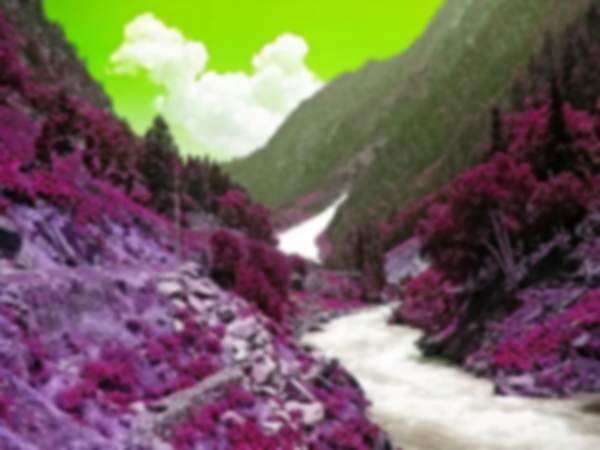

In [19]:
radius_blur = merged_image_gbr.filter(ImageFilter.GaussianBlur(radius=2))
radius_blur

### **Creating Watermark**

In [20]:
from PIL import ImageDraw, ImageFont

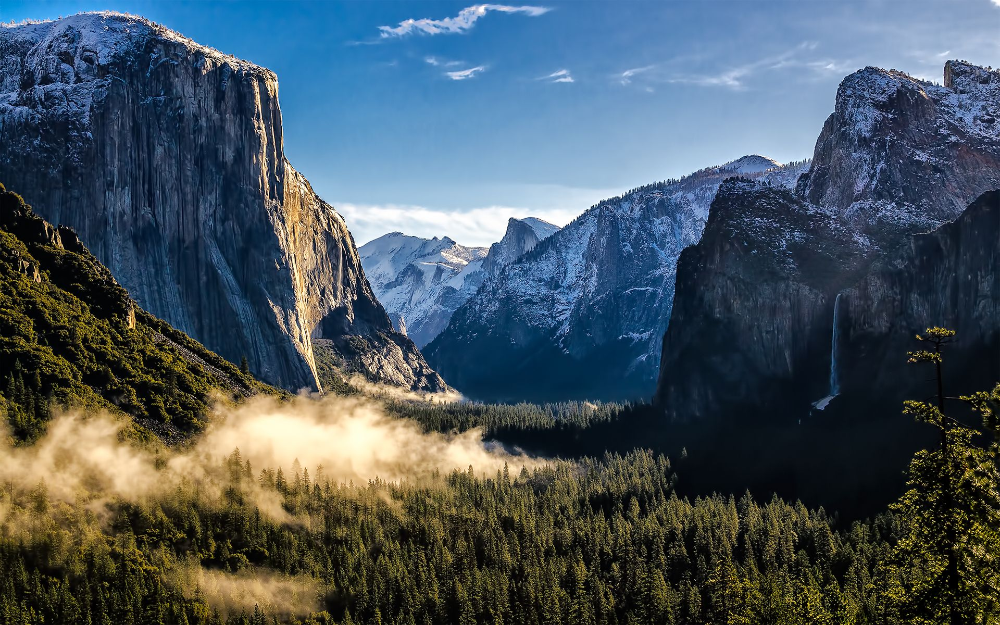

In [21]:
nature_path = get_file("https://i.pinimg.com/originals/e5/60/54/e56054ac4fc07a5477d815d47a76d4ae.jpg")
nature_image = PIL.Image.open(nature_path)
nature_image

In [22]:
draw_1 = ImageDraw.Draw(nature_image)
watermark_text = "Natural Image"
font_size = 60
font = ImageFont.load_default()

# Get the bounding box of the text
bbox = draw_1.textbbox((0, 0), watermark_text, font=font)

# Extract the width and height from the bounding box
text_width = bbox[2] - bbox[0]
text_height = bbox[3] - bbox[1]

print("Text Width:", text_width)
print("Text Height:", text_height)


Text Width: 66
Text Height: 10


In [23]:
# position of z, y coordinate of text
x, y =10, 20
draw_1.text((x, y), watermark_text, font=font)

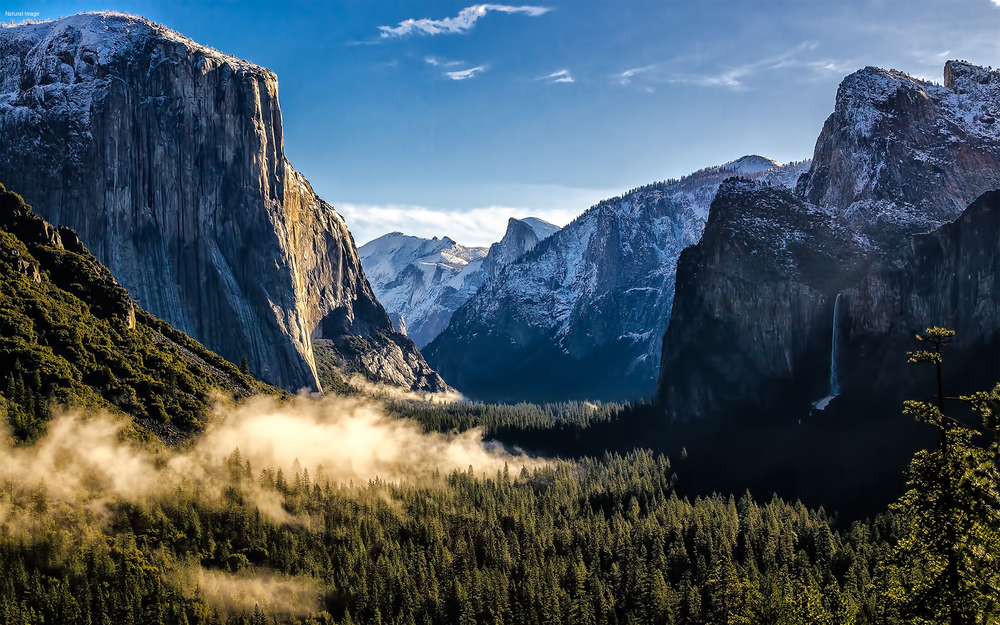

In [24]:
# look into the leftupper point carefully to see the watermark_text
nature_image

In [25]:
# convert color into tuple
PIL.ImageColor.getrgb("red")

(255, 0, 0)

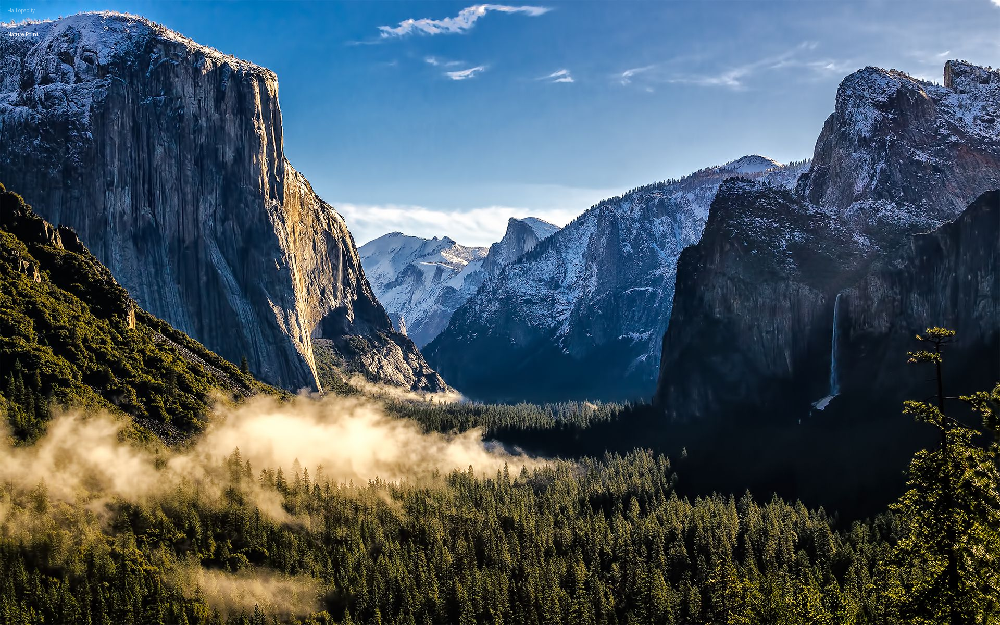

In [26]:
from PIL import Image, ImageDraw, ImageFont

# get an image
img = Image.open(nature_path).convert('RGBA')

# making a blank image for the text, initialized to transparent text color
text1 = Image.new('RGBA', img.size, (255,255,255,0))

# getting a font from the saved library
fnt = ImageFont.load_default()
d = ImageDraw.Draw(text1)

# draw text with the half opacity(last param in fill alpha define the opacity)
d.text((14,14), "Half opacity", font=fnt, fill=(255,255,255,128))

# draw text with the  full opacity
d.text((14,60), "Nature Point", font=fnt, fill=(255,255,255,255))
out = Image.alpha_composite(img, text1)

out